## Python Data Manipulation Modules
Learn how to manipulate data using Numpy and Pandas
    
    AUTHOR: Dr. Roy Jafari 

### Video 10: pandas indexing

####  topics:
- overview of material that must be watched before continuing
- overview of sample data
- Pandas DataFrame Strucutre: every rows or every columns are Pandas Series
- The difference between operators .loc[] and .iloc[]
- Examples with swaplevel()
- Examples with groupby - swaplevel() - stack()/unstack()
- Example Create multi_level index

### Overview of material that must be watched before continuing

- YouTube Video: [Introduction To Pandas](https://youtu.be/zZHGFblaZF8)
- YouTube Video: [Pandas Groupby Function](https://youtu.be/s0-BddFBCjE)
- YouTube Video: [Pandas Apply Function](https://youtu.be/s0-BddFBCjE)

### Overview of sample data

In [3]:
import pandas as pd
import matplotlib.pyplot as plt

In [14]:
shop_df = pd.read_csv('US_Shops_simulated.csv')

In [15]:
shop_df

,Date,Month,Year,State,Location,number_of_customer_visits,revenue,profit
0,2022-09-30,9,2022,Alabama,Shop1,499,1377.74,27.55
1,2022-09-30,9,2022,Alabama,Shop2,504,3733.13,63.46
2,2022-09-30,9,2022,Alabama,Shop3,759,6155.49,98.49
3,2022-09-30,9,2022,Alabama,Shop4,715,7390.96,369.55
4,2022-09-30,9,2022,Alabama,Shop5,538,6502.27,279.60
...,...,...,...,...,...,...,...,...
5470615,2019-10-02,10,2019,Wyoming,Shop119,476,6968.16,222.98
5470616,2019-10-02,10,2019,Wyoming,Shop120,811,6095.48,176.77
5470617,2019-10-02,10,2019,Wyoming,Shop121,637,1818.64,47.28
5470618,2019-10-02,10,2019,Wyoming,Shop122,612,7336.66,278.79


In [17]:
shop_df.iloc[0]

Date                         2022-09-30
Month                                 9
Year                               2022
State                           Alabama
Location                          Shop1
number_of_customer_visits           499
revenue                         1377.74
profit                            27.55
Name: 0, dtype: object

In [6]:
shop_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5470620 entries, 0 to 5470619
Data columns (total 8 columns):
 #   Column                     Dtype  
---  ------                     -----  
 0   Date                       object 
 1   Month                      int64  
 2   Year                       int64  
 3   State                      object 
 4   Location                   object 
 5   number_of_customer_visits  int64  
 6   revenue                    float64
 7   profit                     float64
dtypes: float64(2), int64(3), object(3)
memory usage: 333.9+ MB


### Pandas DataFrame Strucutre: every rows or every columns are Pandas Series

In [7]:
# Every row is a Pandas Series
shop_df.loc[0]

Date                         2022-09-30
Month                                 9
Year                               2022
State                           Alabama
Location                          Shop1
number_of_customer_visits           499
revenue                         1377.74
profit                            27.55
Name: 0, dtype: object

In [8]:
type(shop_df.loc[0])

pandas.core.series.Series

In [11]:
shop_df.loc[0].index

Index(['Date', 'Month', 'Year', 'State', 'Location',
       'number_of_customer_visits', 'revenue', 'profit'],
      dtype='object')

In [9]:
shop_df.Date

0          2022-09-30
1          2022-09-30
2          2022-09-30
3          2022-09-30
4          2022-09-30
              ...    
5470615    2019-10-02
5470616    2019-10-02
5470617    2019-10-02
5470618    2019-10-02
5470619    2019-10-02
Name: Date, Length: 5470620, dtype: object

In [10]:
type(shop_df.Date)

pandas.core.series.Series

In [12]:
shop_df.Date.index

RangeIndex(start=0, stop=5470620, step=1)

### The difference between operators .loc[] and .iloc[]

In [20]:
shop_df = shop_df.set_index('State')
shop_df

,Date,Month,Year,Location,number_of_customer_visits,revenue,profit
State,,,,,,,
Alabama,2022-09-30,9,2022,Shop1,499,1377.74,27.55
Alabama,2022-09-30,9,2022,Shop2,504,3733.13,63.46
Alabama,2022-09-30,9,2022,Shop3,759,6155.49,98.49
Alabama,2022-09-30,9,2022,Shop4,715,7390.96,369.55
Alabama,2022-09-30,9,2022,Shop5,538,6502.27,279.60
...,...,...,...,...,...,...,...
Wyoming,2019-10-02,10,2019,Shop119,476,6968.16,222.98
Wyoming,2019-10-02,10,2019,Shop120,811,6095.48,176.77
Wyoming,2019-10-02,10,2019,Shop121,637,1818.64,47.28


In [21]:
shop_df.iloc[0]

Date                         2022-09-30
Month                                 9
Year                               2022
Location                          Shop1
number_of_customer_visits           499
revenue                         1377.74
profit                            27.55
Name: Alabama, dtype: object

In [23]:
shop_df.loc['California']

,Date,Month,Year,Location,number_of_customer_visits,revenue,profit
State,,,,,,,
California,2022-09-30,9,2022,Shop1,445,1110.28,11.10
California,2022-09-30,9,2022,Shop2,591,6683.03,360.88
California,2022-09-30,9,2022,Shop3,704,7567.30,385.93
California,2022-09-30,9,2022,Shop4,619,5690.47,187.79
California,2022-09-30,9,2022,Shop5,577,3094.45,18.57
...,...,...,...,...,...,...,...
California,2019-10-02,10,2019,Shop56,379,3032.76,151.64
California,2019-10-02,10,2019,Shop57,117,755.24,13.59
California,2019-10-02,10,2019,Shop58,437,1530.81,61.23


### Example:

Find the Revenue of Shop 5 in Mississippi in 2020-05-05, in the fastest possible way.

In [29]:
shop_df = shop_df.reset_index()

In [30]:
shop_df

,State,Date,Location,Month,Year,number_of_customer_visits,revenue,profit
0,Alabama,2022-09-30,Shop1,9,2022,499,1377.74,27.55
1,Alabama,2022-09-30,Shop2,9,2022,504,3733.13,63.46
2,Alabama,2022-09-30,Shop3,9,2022,759,6155.49,98.49
3,Alabama,2022-09-30,Shop4,9,2022,715,7390.96,369.55
4,Alabama,2022-09-30,Shop5,9,2022,538,6502.27,279.60
...,...,...,...,...,...,...,...,...
5470615,Wyoming,2019-10-02,Shop119,10,2019,476,6968.16,222.98
5470616,Wyoming,2019-10-02,Shop120,10,2019,811,6095.48,176.77
5470617,Wyoming,2019-10-02,Shop121,10,2019,637,1818.64,47.28
5470618,Wyoming,2019-10-02,Shop122,10,2019,612,7336.66,278.79


In [31]:
%%time 

BM = (shop_df.State == 'Mississippi') & (shop_df.Date == '2020-05-05') & (shop_df.Location == 'Shop5' )
shop_df[BM]

Wall time: 1.6 s


,State,Date,Location,Month,Year,number_of_customer_visits,revenue,profit
4388710,Mississippi,2020-05-05,Shop5,5,2020,128,454.91,3.18


In [32]:
%%time
shop_df = shop_df.set_index(['State','Date','Location'])
shop_df

Wall time: 1.97 s


Month  Year  number_of_customer_visits  revenue  \
State   Date       Location                                                    
Alabama 2022-09-30 Shop1         9  2022                        499  1377.74   
                   Shop2         9  2022                        504  3733.13   
                   Shop3         9  2022                        759  6155.49   
                   Shop4         9  2022                        715  7390.96   
                   Shop5         9  2022                        538  6502.27   
...                            ...   ...                        ...      ...   
Wyoming 2019-10-02 Shop119      10  2019                        476  6968.16   
                   Shop120      10  2019                        811  6095.48   
                   Shop121      10  2019                        637  1818.64   
                   Shop122      10  2019                        612  7336.66   
                   Shop123      10  2019                        215  2419.83   

                             profit  
State   Date       Location          
Alabama 2022-09-30 Shop1      27.55  
                   Shop2      63.46  
                   Shop3      98.49  
                   Shop4     369.55  
                   Shop5     279.60  
...                             ...  
Wyoming 2019-10-02 Shop119   222.98  
                   Shop120   176.77  
                   Shop121    47.28  
                   Shop122   278.79  
                   Shop123    38.72  

[5470620 rows x 5 columns]

In [38]:
%%time
shop_df.loc['Mississippi'].loc['2020-05-05'].loc['Shop5']

Wall time: 25.3 ms


Month                           5.00
Year                         2020.00
number_of_customer_visits     128.00
revenue                       454.91
profit                          3.18
Name: Shop5, dtype: float64

In [39]:
%%time
shop_df.loc[('Mississippi','2020-05-05','Shop5')]

Wall time: 501 µs


Month                           5.00
Year                         2020.00
number_of_customer_visits     128.00
revenue                       454.91
profit                          3.18
Name: (Mississippi, 2020-05-05, Shop5), dtype: float64

## Example of swaplevel()

Draw line plots of profit for all of the shops in California. 

In [40]:
shop_df.loc['California']

Month  Year  number_of_customer_visits  revenue  profit
Date       Location                                                         
2022-09-30 Shop1         9  2022                        445  1110.28   11.10
           Shop2         9  2022                        591  6683.03  360.88
           Shop3         9  2022                        704  7567.30  385.93
           Shop4         9  2022                        619  5690.47  187.79
           Shop5         9  2022                        577  3094.45   18.57
...                    ...   ...                        ...      ...     ...
2019-10-02 Shop56       10  2019                        379  3032.76  151.64
           Shop57       10  2019                        117   755.24   13.59
           Shop58       10  2019                        437  1530.81   61.23
           Shop59       10  2019                        477  2418.87   94.34
           Shop60       10  2019                        552  5324.04   63.89

[65700 rows x 5 columns]

In [41]:
cal_shop_df = shop_df.loc['California'].swaplevel()
cal_shop_df

,,Month,Year,number_of_customer_visits,revenue,profit
Location,Date,,,,,
Shop1,2022-09-30,9,2022,445,1110.28,11.10
Shop2,2022-09-30,9,2022,591,6683.03,360.88
Shop3,2022-09-30,9,2022,704,7567.30,385.93
Shop4,2022-09-30,9,2022,619,5690.47,187.79
Shop5,2022-09-30,9,2022,577,3094.45,18.57
...,...,...,...,...,...,...
Shop56,2019-10-02,10,2019,379,3032.76,151.64
Shop57,2019-10-02,10,2019,117,755.24,13.59
Shop58,2019-10-02,10,2019,437,1530.81,61.23


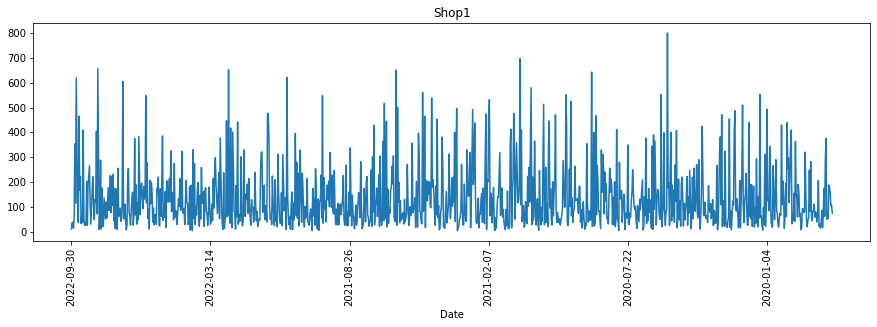

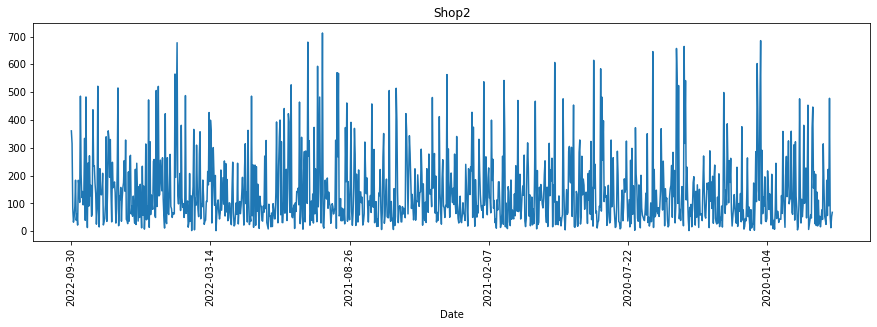

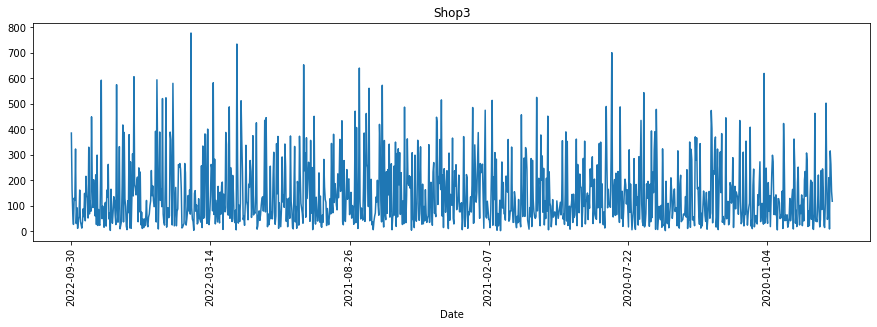

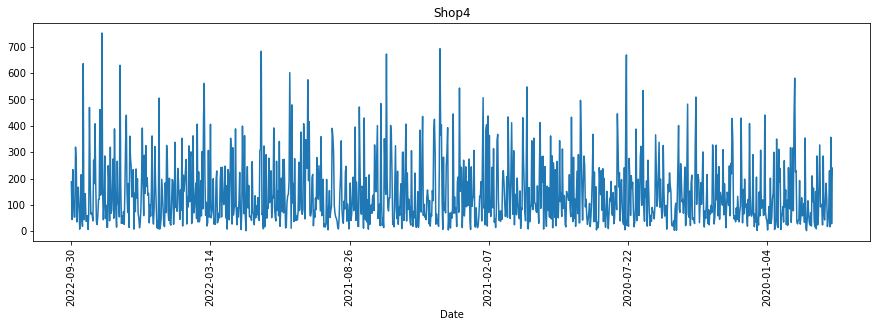

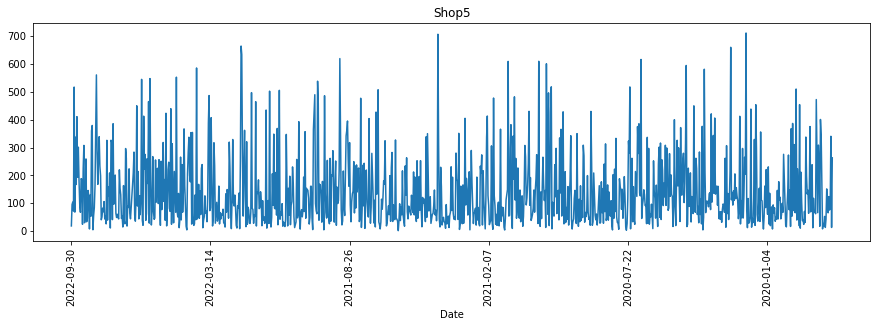

...

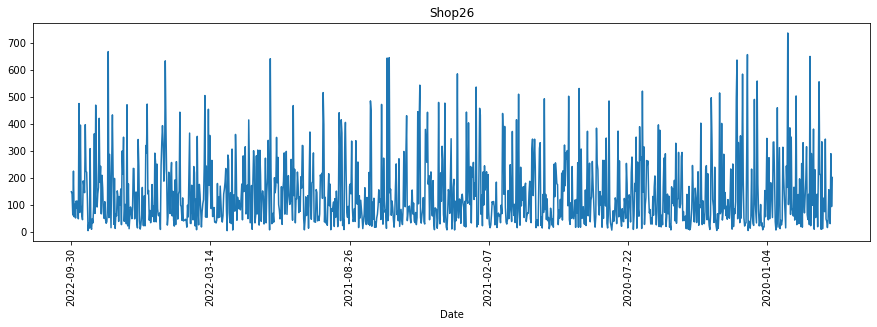

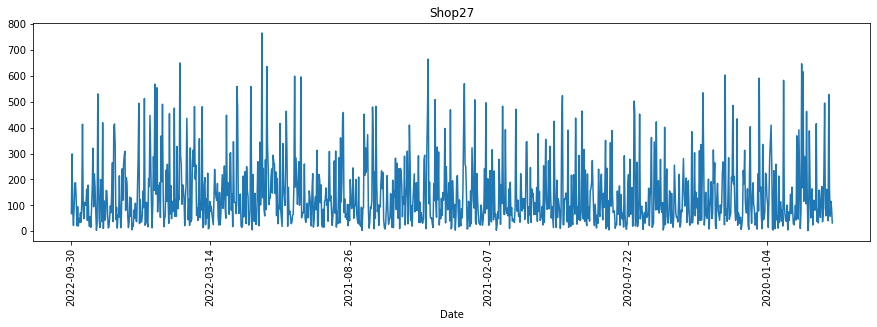

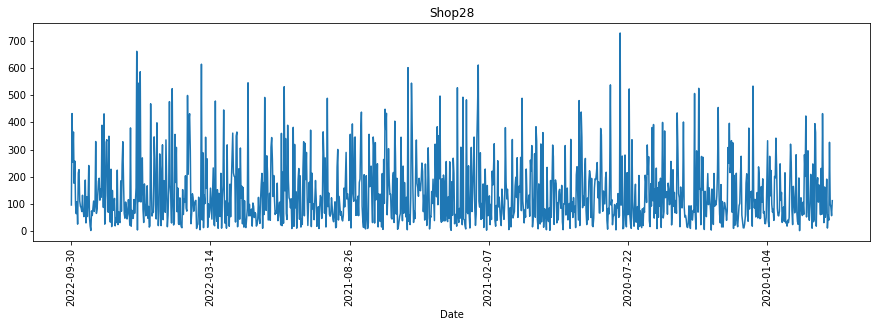

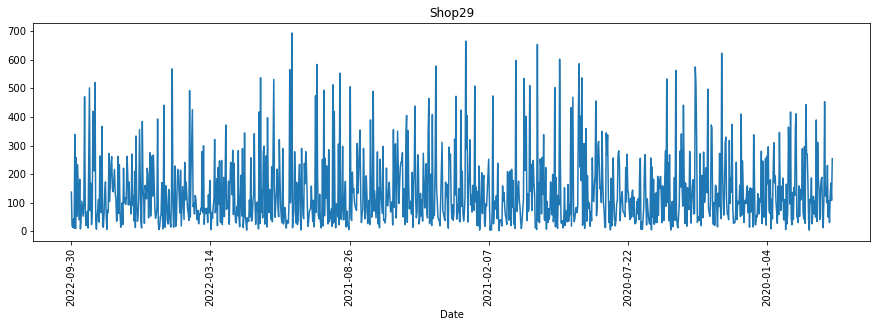

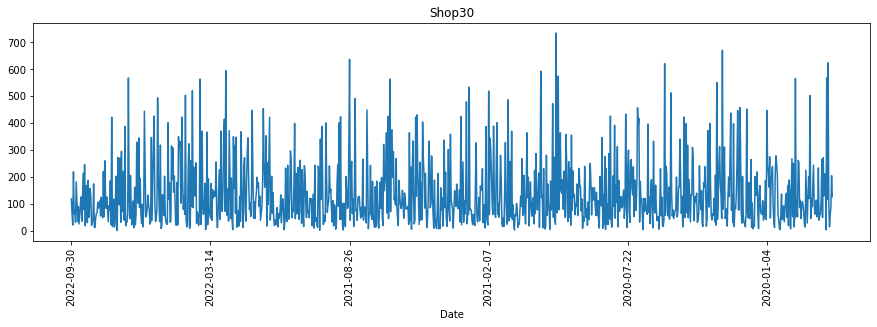

KeyboardInterrupt: 

In [42]:
import matplotlib.pyplot as plt
for l in cal_shop_df.reset_index().Location:
    cal_shop_df.loc[l].profit.plot(figsize=(15,4))
    plt.xticks(rotation=90)
    plt.title(l)
    plt.show()

### Second Example of swaplevel()
Quickly gather a DataFrame that shows all the shops at 2019-07-07. 

In [48]:
shop_df.swaplevel('State','Location')

,,,Month,Year,number_of_customer_visits,revenue,profit
Location,Date,State,,,,,
Shop1,2022-09-30,Alabama,9,2022,499,1377.74,27.55
Shop2,2022-09-30,Alabama,9,2022,504,3733.13,63.46
Shop3,2022-09-30,Alabama,9,2022,759,6155.49,98.49
Shop4,2022-09-30,Alabama,9,2022,715,7390.96,369.55
Shop5,2022-09-30,Alabama,9,2022,538,6502.27,279.60
...,...,...,...,...,...,...,...
Shop119,2019-10-02,Wyoming,10,2019,476,6968.16,222.98
Shop120,2019-10-02,Wyoming,10,2019,811,6095.48,176.77
Shop121,2019-10-02,Wyoming,10,2019,637,1818.64,47.28


In [49]:
shop_df.swaplevel('Date','State').loc['2020-07-07']

Month  Year  number_of_customer_visits   revenue  profit
State   Location                                                          
Alabama Shop1         7  2020                        325   1481.68   31.12
        Shop2         7  2020                        586   7674.84  184.20
        Shop3         7  2020                        715  10521.22  347.20
        Shop4         7  2020                        116    745.88   26.85
        Shop5         7  2020                        897   2037.98   32.61
...                 ...   ...                        ...       ...     ...
Wyoming Shop119       7  2020                        289   3335.93   96.74
        Shop120       7  2020                        920  12755.80  140.31
        Shop121       7  2020                        922   7744.80   92.94
        Shop122       7  2020                        748   4655.55  139.67
        Shop123       7  2020                        785   7904.17  324.07

[4996 rows x 5 columns]

## Example Groupby - swaplevel() - stack()/unstack()
Calculate and show the yearly revenue and profit of all the shops.

In [50]:
shop_df = shop_df.reset_index()

In [51]:
result_df=shop_df.groupby(['State','Location','Year'])[['revenue','profit']].sum()
result_df

revenue    profit
State   Location Year                      
Alabama Shop1    2019   430116.60  12883.80
                 2020  1632955.01  48321.85
                 2021  1712280.57  51093.37
                 2022  1167575.31  34978.49
        Shop10   2019   412150.53  12184.09
...                           ...       ...
Wyoming Shop98   2022  1254170.33  37951.20
        Shop99   2019   383441.78  11475.56
                 2020  1668891.72  49695.87
                 2021  1668357.93  48601.96
                 2022  1268164.82  36512.83

[19984 rows x 2 columns]

In [52]:
result_df.unstack()

revenue                                        profit  \
Year                   2019        2020        2021        2022      2019   
State   Location                                                            
Alabama Shop1     430116.60  1632955.01  1712280.57  1167575.31  12883.80   
        Shop10    412150.53  1792329.76  1649090.67  1277252.24  12184.09   
        Shop11    433506.90  1683451.84  1773853.32  1240966.68  12921.84   
        Shop12    379752.28  1712031.59  1633071.00  1331590.15  11028.25   
        Shop13    374308.45  1804608.97  1780988.09  1287213.63  10782.63   
...                     ...         ...         ...         ...       ...   
Wyoming Shop95    410497.24  1698666.75  1804151.21  1273088.53  11167.07   
        Shop96    432972.82  1632759.99  1656233.73  1274484.43  13486.16   
        Shop97    481142.22  1684015.91  1925616.61  1334636.29  14602.55   
        Shop98    424098.48  1762486.25  1683850.25  1254170.33  12654.61   
        Shop99    383441.78  1668891.72  1668357.93  1268164.82  11475.56   

                                                
Year                  2020      2021      2022  
State   Location                                
Alabama Shop1     48321.85  51093.37  34978.49  
        Shop10    54438.17  51122.49  38542.40  
        Shop11    50266.10  50456.93  37491.70  
        Shop12    53029.97  49299.76  42657.33  
        Shop13    54900.19  54233.58  41123.35  
...                    ...       ...       ...  
Wyoming Shop95    48719.66  52009.50  38992.63  
        Shop96    49640.63  48355.09  38761.99  
        Shop97    49694.57  58082.21  38640.62  
        Shop98    52272.10  48992.63  37951.20  
        Shop99    49695.87  48601.96  36512.83  

[4996 rows x 8 columns]

In [54]:
result_df.unstack()['profit'][2022]

State    Location
Alabama  Shop1       34978.49
         Shop10      38542.40
         Shop11      37491.70
         Shop12      42657.33
         Shop13      41123.35
                       ...   
Wyoming  Shop95      38992.63
         Shop96      38761.99
         Shop97      38640.62
         Shop98      37951.20
         Shop99      36512.83
Name: 2022, Length: 4996, dtype: float64

In [55]:
result_df.unstack()['profit'][2022].unstack()

Location,Shop1,Shop10,Shop100,Shop101,Shop102,Shop103,Shop104,Shop105,Shop106,Shop107,...,Shop90,Shop91,Shop92,Shop93,Shop94,Shop95,Shop96,Shop97,Shop98,Shop99
State,,,,,,,,,,,,,,,,,,,,,
Alabama,34978.49,38542.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Alaska,37167.02,35313.50,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Arizona,37968.57,36154.86,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Arkansas,36632.47,38181.56,37825.73,39592.46,40838.32,36295.96,40258.44,35581.04,37756.26,37554.99,...,34387.10,36045.99,39315.60,35801.89,34399.94,38609.08,36602.03,40664.02,37111.53,39307.83
California,36179.93,40291.69,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Colorado,38506.72,38297.72,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Connecticut,37815.21,39135.15,39360.49,40780.96,37933.26,39154.14,42888.04,37356.39,36077.17,36774.66,...,40371.16,34143.44,39222.83,37441.92,38558.31,42350.26,40331.85,36754.44,39572.12,37238.50
Delaware,36090.64,38054.68,40174.08,38891.36,37071.63,36967.83,38526.05,34505.80,38906.38,36619.40,...,42381.06,39070.56,39238.45,38654.34,40351.54,38906.71,36512.84,37103.84,39725.27,40602.83
Florida,39479.69,35947.66,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Example Create multi_level index

In [56]:
order_df = pd.read_csv('orders.csv')

In [57]:
order_df

,Shops,Date,quantity
0,shop_18,2022-09-26,1.0
1,shop_6,2022-09-25,12.0
2,shop_8,2022-09-25,4.0
3,shop_1,2022-09-24,25.0
4,shop_6,2022-09-24,11.0
...,...,...,...
6339,shop_15,2021-09-28,1912.0
6340,shop_16,2021-09-28,1451.0
6341,shop_17,2021-09-28,1049.0
6342,shop_18,2021-09-28,703.0


In [58]:
order_df.Date = pd.to_datetime(order_df.Date)

In [59]:
order_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6344 entries, 0 to 6343
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Shops     6344 non-null   object        
 1   Date      6344 non-null   datetime64[ns]
 2   quantity  6344 non-null   float64       
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 148.8+ KB


In [60]:
shops = order_df.Shops.unique()

In [61]:
shops

array(['shop_18', 'shop_6', 'shop_8', 'shop_1', 'shop_10', 'shop_15',
       'shop_4', 'shop_13', 'shop_9', 'shop_17', 'shop_5', 'shop_12',
       'shop_7', 'shop_11', 'shop_19', 'shop_2', 'shop_16', 'shop_0',
       'shop_14', 'shop_3'], dtype=object)

In [62]:
order_df = order_df.set_index(['Shops','Date'])
order_df

,,quantity
Shops,Date,
shop_18,2022-09-26,1.0
shop_6,2022-09-25,12.0
shop_8,2022-09-25,4.0
shop_1,2022-09-24,25.0
shop_6,2022-09-24,11.0
...,...,...
shop_15,2021-09-28,1912.0
shop_16,2021-09-28,1451.0
shop_17,2021-09-28,1049.0


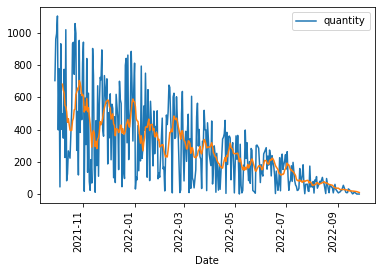

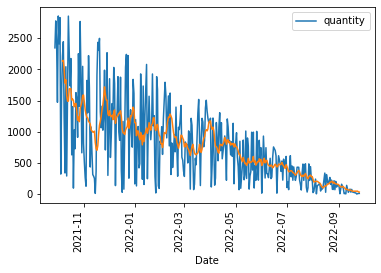

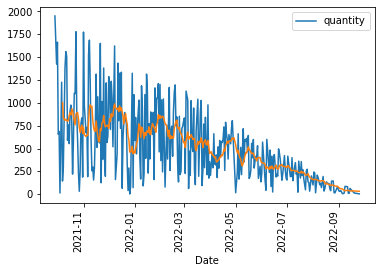

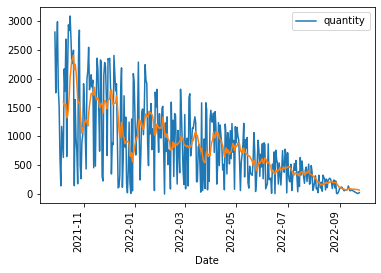

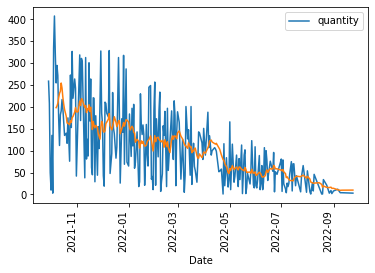

...

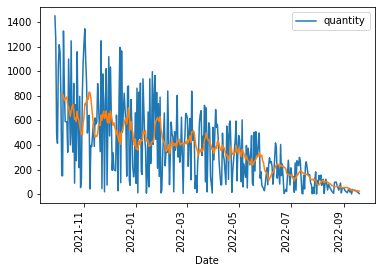

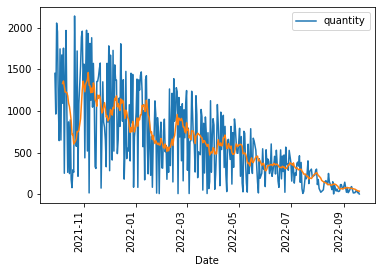

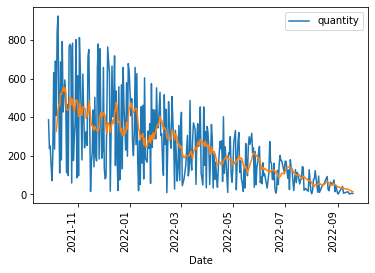

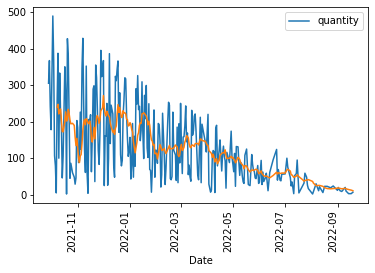

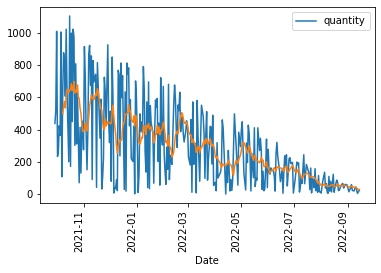

In [63]:
for s in shops:
    wdf = order_df.loc[s].sort_index()
    wdf.plot()
    wdf.rolling(window=10).quantity.mean().plot()
    plt.xticks(rotation=90)
    plt.show()

In [64]:
order_df.loc['shop_1'].sort_index()[-20:]

,quantity
Date,
2022-08-25,245.0
2022-08-26,106.0
2022-08-27,227.0
2022-08-28,13.0
2022-08-29,6.0
2022-08-30,26.0
2022-08-31,63.0
2022-09-01,117.0
2022-09-02,107.0


In [65]:
order_df.loc['shop_2'].sort_index()[-20:]

,quantity
Date,
2022-08-20,7.0
2022-08-21,96.0
2022-08-23,99.0
2022-08-24,71.0
2022-08-26,32.0
2022-08-28,91.0
2022-08-29,10.0
2022-08-30,47.0
2022-09-01,54.0


### Create a Full DataFrame and using update it 

#### using pd.MultiIndex.from_arrays()

In [66]:
shops = [f'shop_{i}' for i in range(20)]
shops

['shop_0',
 'shop_1',
 'shop_2',
 'shop_3',
 'shop_4',
 'shop_5',
 'shop_6',
 'shop_7',
 'shop_8',
 'shop_9',
 'shop_10',
 'shop_11',
 'shop_12',
 'shop_13',
 'shop_14',
 'shop_15',
 'shop_16',
 'shop_17',
 'shop_18',
 'shop_19']

In [67]:
order_df = order_df.reset_index()

In [68]:
order_df.Date = pd.to_datetime(order_df.Date)

In [69]:
order_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6344 entries, 0 to 6343
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Shops     6344 non-null   object        
 1   Date      6344 non-null   datetime64[ns]
 2   quantity  6344 non-null   float64       
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 148.8+ KB


In [70]:
f_date = order_df.Date.min()
l_date = order_df.Date.max()
print(f_date,l_date)

2021-09-28 00:00:00 2022-09-26 00:00:00


In [71]:
l_date - f_date

Timedelta('363 days 00:00:00')

In [72]:
import datetime
dates = [f_date + datetime.timedelta(i) for i in range(364)]
dates

[Timestamp('2021-09-28 00:00:00'),
 Timestamp('2021-09-29 00:00:00'),
 Timestamp('2021-09-30 00:00:00'),
 Timestamp('2021-10-01 00:00:00'),
 Timestamp('2021-10-02 00:00:00'),
 Timestamp('2021-10-03 00:00:00'),
 Timestamp('2021-10-04 00:00:00'),
 Timestamp('2021-10-05 00:00:00'),
 Timestamp('2021-10-06 00:00:00'),
 Timestamp('2021-10-07 00:00:00'),
 Timestamp('2021-10-08 00:00:00'),
 Timestamp('2021-10-09 00:00:00'),
 Timestamp('2021-10-10 00:00:00'),
 Timestamp('2021-10-11 00:00:00'),
 Timestamp('2021-10-12 00:00:00'),
 Timestamp('2021-10-13 00:00:00'),
 Timestamp('2021-10-14 00:00:00'),
 Timestamp('2021-10-15 00:00:00'),
 Timestamp('2021-10-16 00:00:00'),
 Timestamp('2021-10-17 00:00:00'),
 Timestamp('2021-10-18 00:00:00'),
 Timestamp('2021-10-19 00:00:00'),
 Timestamp('2021-10-20 00:00:00'),
 Timestamp('2021-10-21 00:00:00'),
 Timestamp('2021-10-22 00:00:00'),
 Timestamp('2021-10-23 00:00:00'),
 Timestamp('2021-10-24 00:00:00'),
 Timestamp('2021-10-25 00:00:00'),
 Timestamp('2021-10-

In [73]:
f_level = []
s_level = []

for s in shops:
    for d in dates:
        f_level.append(s)
        s_level.append(d)
f_level

['shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',
 'shop_0',

In [74]:
s_level

[Timestamp('2021-09-28 00:00:00'),
 Timestamp('2021-09-29 00:00:00'),
 Timestamp('2021-09-30 00:00:00'),
 Timestamp('2021-10-01 00:00:00'),
 Timestamp('2021-10-02 00:00:00'),
 Timestamp('2021-10-03 00:00:00'),
 Timestamp('2021-10-04 00:00:00'),
 Timestamp('2021-10-05 00:00:00'),
 Timestamp('2021-10-06 00:00:00'),
 Timestamp('2021-10-07 00:00:00'),
 Timestamp('2021-10-08 00:00:00'),
 Timestamp('2021-10-09 00:00:00'),
 Timestamp('2021-10-10 00:00:00'),
 Timestamp('2021-10-11 00:00:00'),
 Timestamp('2021-10-12 00:00:00'),
 Timestamp('2021-10-13 00:00:00'),
 Timestamp('2021-10-14 00:00:00'),
 Timestamp('2021-10-15 00:00:00'),
 Timestamp('2021-10-16 00:00:00'),
 Timestamp('2021-10-17 00:00:00'),
 Timestamp('2021-10-18 00:00:00'),
 Timestamp('2021-10-19 00:00:00'),
 Timestamp('2021-10-20 00:00:00'),
 Timestamp('2021-10-21 00:00:00'),
 Timestamp('2021-10-22 00:00:00'),
 Timestamp('2021-10-23 00:00:00'),
 Timestamp('2021-10-24 00:00:00'),
 Timestamp('2021-10-25 00:00:00'),
 Timestamp('2021-10-

In [75]:
my_index = pd.MultiIndex.from_arrays([f_level,s_level], names=('Shops', 'Date'))
my_index

MultiIndex([( 'shop_0', '2021-09-28'),
            ( 'shop_0', '2021-09-29'),
            ( 'shop_0', '2021-09-30'),
            ( 'shop_0', '2021-10-01'),
            ( 'shop_0', '2021-10-02'),
            ( 'shop_0', '2021-10-03'),
            ( 'shop_0', '2021-10-04'),
            ( 'shop_0', '2021-10-05'),
            ( 'shop_0', '2021-10-06'),
            ( 'shop_0', '2021-10-07'),
            ...
            ('shop_19', '2022-09-17'),
            ('shop_19', '2022-09-18'),
            ('shop_19', '2022-09-19'),
            ('shop_19', '2022-09-20'),
            ('shop_19', '2022-09-21'),
            ('shop_19', '2022-09-22'),
            ('shop_19', '2022-09-23'),
            ('shop_19', '2022-09-24'),
            ('shop_19', '2022-09-25'),
            ('shop_19', '2022-09-26')],
           names=['Shops', 'Date'], length=7280)

In [76]:
stage_df = pd.DataFrame(0.0, index=my_index,columns=['quantity'])
stage_df

quantity
Shops   Date                
shop_0  2021-09-28       0.0
        2021-09-29       0.0
        2021-09-30       0.0
        2021-10-01       0.0
        2021-10-02       0.0
...                      ...
shop_19 2022-09-22       0.0
        2022-09-23       0.0
        2022-09-24       0.0
        2022-09-25       0.0
        2022-09-26       0.0

[7280 rows x 1 columns]

In [77]:
stage_df.update(order_df)

In [78]:
stage_df

quantity
Shops   Date                
shop_0  2021-09-28       0.0
        2021-09-29       0.0
        2021-09-30       0.0
        2021-10-01       0.0
        2021-10-02       0.0
...                      ...
shop_19 2022-09-22       0.0
        2022-09-23       0.0
        2022-09-24       0.0
        2022-09-25       0.0
        2022-09-26       0.0

[7280 rows x 1 columns]

In [79]:
order_df

,Shops,Date,quantity
0,shop_18,2022-09-26,1.0
1,shop_6,2022-09-25,12.0
2,shop_8,2022-09-25,4.0
3,shop_1,2022-09-24,25.0
4,shop_6,2022-09-24,11.0
...,...,...,...
6339,shop_15,2021-09-28,1912.0
6340,shop_16,2021-09-28,1451.0
6341,shop_17,2021-09-28,1049.0
6342,shop_18,2021-09-28,703.0


In [80]:
stage_df.update(order_df.set_index(['Shops','Date']))

In [81]:
stage_df

quantity
Shops   Date                
shop_0  2021-09-28     387.0
        2021-09-29     238.0
        2021-09-30     251.0
        2021-10-01     151.0
        2021-10-02      71.0
...                      ...
shop_19 2022-09-22       0.0
        2022-09-23       0.0
        2022-09-24       0.0
        2022-09-25       0.0
        2022-09-26       0.0

[7280 rows x 1 columns]

In [82]:
stage_df.loc['shop_1'].sort_index()[-20:]

,quantity
Date,
2022-09-07,0.0
2022-09-08,72.0
2022-09-09,75.0
2022-09-10,77.0
2022-09-11,140.0
2022-09-12,0.0
2022-09-13,56.0
2022-09-14,0.0
2022-09-15,70.0


### using pd.MultiIndex.from_product()

In [86]:
my_index = pd.MultiIndex.from_product([shops,dates], names=('Shops', 'Date'))
stage_df = pd.DataFrame(0.0, index=my_index,columns=['quantity'])
stage_df

quantity
Shops   Date                
shop_0  2021-09-28       0.0
        2021-09-29       0.0
        2021-09-30       0.0
        2021-10-01       0.0
        2021-10-02       0.0
...                      ...
shop_19 2022-09-22       0.0
        2022-09-23       0.0
        2022-09-24       0.0
        2022-09-25       0.0
        2022-09-26       0.0

[7280 rows x 1 columns]

In [87]:
stage_df.update(order_df.set_index(['Shops','Date']))

In [88]:
stage_df

quantity
Shops   Date                
shop_0  2021-09-28     387.0
        2021-09-29     238.0
        2021-09-30     251.0
        2021-10-01     151.0
        2021-10-02      71.0
...                      ...
shop_19 2022-09-22       0.0
        2022-09-23       0.0
        2022-09-24       0.0
        2022-09-25       0.0
        2022-09-26       0.0

[7280 rows x 1 columns]

In [89]:
order_df = order_df.set_index(['Shops','Date'])

In [90]:
order_df

,,quantity
Shops,Date,
shop_18,2022-09-26,1.0
shop_6,2022-09-25,12.0
shop_8,2022-09-25,4.0
shop_1,2022-09-24,25.0
shop_6,2022-09-24,11.0
...,...,...
shop_15,2021-09-28,1912.0
shop_16,2021-09-28,1451.0
shop_17,2021-09-28,1049.0


In [ ]:
for s in shops:
    fig, axs = plt.subplots(1,2,figsize=(15,5))
    
    wdf = order_df.loc[s].sort_index()
    wdf.plot(ax=axs[0])
    wdf.rolling(window=10).quantity.mean().plot(ax=axs[0])
    plt.xticks(rotation=90)
    
    plt.subplot(1,2,2)
    wdf = stage_df.loc[s].sort_index()
    wdf.plot(ax=axs[1])
    wdf.rolling(window=10).quantity.mean().plot(ax=axs[1])
    plt.xticks(rotation=90)
    plt.show()